In [5]:
%pip install geopandas
%pip install requests
%pip install scipy
%pip install rasterio
%pip install matplotlib
%pip install mapclassify
%pip install folium

Note: you may need to restart the kernel to use updated packages.



[notice] A new release of pip available: 22.3.1 -> 23.1.1
[notice] To update, run: python.exe -m pip install --upgrade pip


Note: you may need to restart the kernel to use updated packages.



[notice] A new release of pip available: 22.3.1 -> 23.1.1
[notice] To update, run: python.exe -m pip install --upgrade pip


Note: you may need to restart the kernel to use updated packages.



[notice] A new release of pip available: 22.3.1 -> 23.1.1
[notice] To update, run: python.exe -m pip install --upgrade pip



[notice] A new release of pip available: 22.3.1 -> 23.1.1
[notice] To update, run: python.exe -m pip install --upgrade pip



[notice] A new release of pip available: 22.3.1 -> 23.1.1
[notice] To update, run: python.exe -m pip install --upgrade pip



Note: you may need to restart the kernel to use updated packages.



[notice] A new release of pip available: 22.3.1 -> 23.1.1
[notice] To update, run: python.exe -m pip install --upgrade pip


Note: you may need to restart the kernel to use updated packages.



[notice] A new release of pip available: 22.3.1 -> 23.1.1
[notice] To update, run: python.exe -m pip install --upgrade pip


- Useful Functions

In [6]:
import datetime
import numpy as np
import geopandas as gpd
import json
import shapely
import requests
import rasterio
import matplotlib.pyplot as plt
from rasterio.plot import show
from scipy.interpolate import make_interp_spline

# =====================================================================================
# Normalize: Normalize an Array to [0, 1]
# =====================================================================================
def normalize (dat):
    dat_min, dat_max = dat.min (), dat.max ()
    return ((dat - dat_min) / (dat_max - dat_min))

# =====================================================================================
# ndvi: Given Nir & Red Bands, create an ndvi band
# =====================================================================================
def ndvi (nir, red):
    return ((nir - red) / (nir + red))

# =====================================================================================
# rgb_composite (img, red, green, blue)
# -------------------------------------------------------------------------------------
#   Given Image <img> and <red>, <green>, <blue>, Band Indices,
#   return Normalized RGB composite.
# =====================================================================================
def rgb_composite (img, red, green, blue):

    rr = normalize (img.read (red  ))  
    gg = normalize (img.read (green))
    bb = normalize (img.read (blue ))

    return np.dstack ((rr, gg, bb))

# =====================================================================================
# For Image Cube Kasroria.tif, Create a List of datetime Objects
# =====================================================================================
def plot_series (xSeries, ySeries, ax, c, lw):

    x, y = np.array (xSeries), np.array (ySeries)

    xySpline = make_interp_spline (x, y)
    
    # Returns evenly spaced numbers
    # over a specified interval.
    Xs = np.linspace (x.min(), x.max(), 128)
    Ys = xySpline (Xs)
    
    # Plotting the Graph
    ax.plot (Xs, Ys,      color = c, lw = lw)
    ax.plot (x , y , 'o', color = c, lw = lw)
    ax.grid ()

# =====================================================================================
# For Image Cube Kasroria.tif, Create a List of datetime Objects
# =====================================================================================
kast_doy = [
      25,  45,  88,  95, 118, 158, 185, 195, 205, 208, 218, 225, 
     228, 235, 248, 258, 275, 288, 318, 338, 345, 355, 358, 365
 ]

# kast_img_dates = [ 
#     datetime.datetime (2016, 1, 1) + datetime.timedelta (v - 1) for v in kast_doy
# ]

kast_img_dates = [
    datetime.datetime (2016,  1, 25), datetime.datetime (2016,  2, 14), 
    datetime.datetime (2016,  3, 28), datetime.datetime (2016,  4,  4), 
    datetime.datetime (2016,  4, 27), datetime.datetime (2016,  6,  6), 
    datetime.datetime (2016,  7,  3), datetime.datetime (2016,  7, 13), 
    datetime.datetime (2016,  7, 23), datetime.datetime (2016,  7, 26), 
    datetime.datetime (2016,  8,  5), datetime.datetime (2016,  8, 12), 
    datetime.datetime (2016,  8, 15), datetime.datetime (2016,  8, 22), 
    datetime.datetime (2016,  9,  4), datetime.datetime (2016,  9, 14), 
    datetime.datetime (2016, 10,  1), datetime.datetime (2016, 10, 14), 
    datetime.datetime (2016, 11, 13), datetime.datetime (2016, 12,  3), 
    datetime.datetime (2016, 12, 10), datetime.datetime (2016, 12, 20), 
    datetime.datetime (2016, 12, 23), datetime.datetime (2016, 12, 30) 
]

# =====================================================================================
# (C) Valsamis Ntouskos
# -------------------------------------------------------------------------------------
# Downloads Corine Land Cover 2018 data from Copernicus REST API
# =====================================================================================
def _wkt2esri(wkt:str)->str:
    """Converts WKT geometries to arcGIS geometry strings.
    
    Args:
        wkt (str): WKT geometry string
    Returns:
        str: ESRI arcGIS polygon geometry string
    """
    geom = shapely.wkt.loads(wkt)
    rings = None
    # Testing for polygon type
    if geom.geom_type == 'MultiPolygon':
        rings = []
        for pg in geom.geoms:
            rings += [list(pg.exterior.coords)] + [list(interior.coords) for interior in pg.interiors]    
    elif geom.geom_type == 'Polygon':
        rings = [list(geom.exterior.coords)] + [list(interior.coords) for interior in geom.interiors]
    else:
        print("Shape is not a polygon")
        return None
            
    # Convert to esri geometry json    
    esri = json.dumps({'rings': rings})

    return esri

# =====================================================================================

def corine (aoi:str, to_file:bool = False, fname:str = "corine_2018.shp")->tuple:
    """Downloads Corine Land Cover 2018 data from Copernicus REST API.
    
    Args:
        aoi (str): Path to file with the region of interest
        to_file (bool, optional): Save result to file. Defaults to False
        fname (str, optional): Path and name of the created file. Defaults to "corine_2018.shp"
    Returns:
        tuple: Corine Land Cover 2018 data as GeoDataFrame and the path to saved file
    """
    HTTP_OK = 200

    geoms = gpd.read_file(aoi).dissolve()
    polygons = list(geoms.geometry)
    wkt = f"{polygons[0]}"

    esri = _wkt2esri(wkt)
    
    # Build URL for retrieving data
    server = "https://image.discomap.eea.europa.eu/arcgis/rest/services/Corine/CLC2018_WM/MapServer/0/query?"
    payload = {
        "geometry": esri, 
        "f": "GeoJSON",
        "inSR": geoms.crs.to_epsg(),
        "geometryType": "esriGeometryPolygon",
        "spatialRel": "esriSpatialRelIntersects",
        "returnGeometry": True
        }
    print ("Starting retrieval...")
    request = requests.get(server, params = payload)

    # Check if server didn't respond to HTTP code = 200

    if request.status_code != HTTP_OK:
        raise requests.exceptions.HTTPError("Failed retrieving POWER data, server returned HTTP code: {} on following URL {}.".format(request.status_code, request.url))
    
    # In other case is successful
    print ("Successfully retrieved data!")
    json_data = request.json()
    data = gpd.GeoDataFrame.from_features(json_data)
    if to_file:
        data.to_file(fname)
    
    return data, fname

# Example usage to download shapefile based on a given geometry
# data, fname = corine("<path to geojson file defining geometry>", True, "<path to output shape file>")

# =====================================================================================
# Corine Land Cover Color Codes
# -------------------------------------------------------------------------------------
dict_corine = {
    111 : '#e6004d', 112 : '#ff0000', 211 : '#ff0000', 121 : '#cc4df2', 
    122 : '#cc0000', 123 : '#e6cccc', 124 : '#e6cce6', 131 : '#a600cc', 
    132 : '#a64d00', 133 : '#ff4dff', 141 : '#ffa6ff', 142 : '#ffe6ff', 
    211 : '#ffffa8', 212 : '#ffff00', 213 : '#e6e600', 221 : '#e68000',
    222 : '#f2a64d', 223 : '#e6a600', 231 : '#e6e64d', 241 : '#ffe6a6', 
    242 : '#ffe64d', 243 : '#e6cc4d', 244 : '#f2cca6', 311 : '#80ff00', 
    312 : '#00a600', 313 : '#4dff00', 321 : '#ccf24d', 322 : '#a6ff80', 
    323 : '#a6e64d', 324 : '#a6f200', 331 : '#e6e6e6', 332 : '#cccccc',
    333 : '#ccffcc', 334 : '#000000', 335 : '#a6e6cc', 411 : '#a6a6ff',
    412 : '#4d4dff', 421 : '#ccccff', 422 : '#e6e6ff', 423 : '#a6a6e6', 
    511 : '#00ccf2', 512 : '#80f2e6', 521 : '#00ffa6', 522 : '#a6ffe6', 
    523 : '#e6f2ff', 999 : '#ffffff'    
}



## 1α. Διαχρονικά Δεδομένα Sentinel-2 ##
___

- Εισαγωγή Raster Χωρο/χρονo-φασματικού Κύβου Sentinel-2 της ευρύτερης πειοχής Καστοριάς, με χρήση της βιβλιοθήκης rasterio.

0.35522336


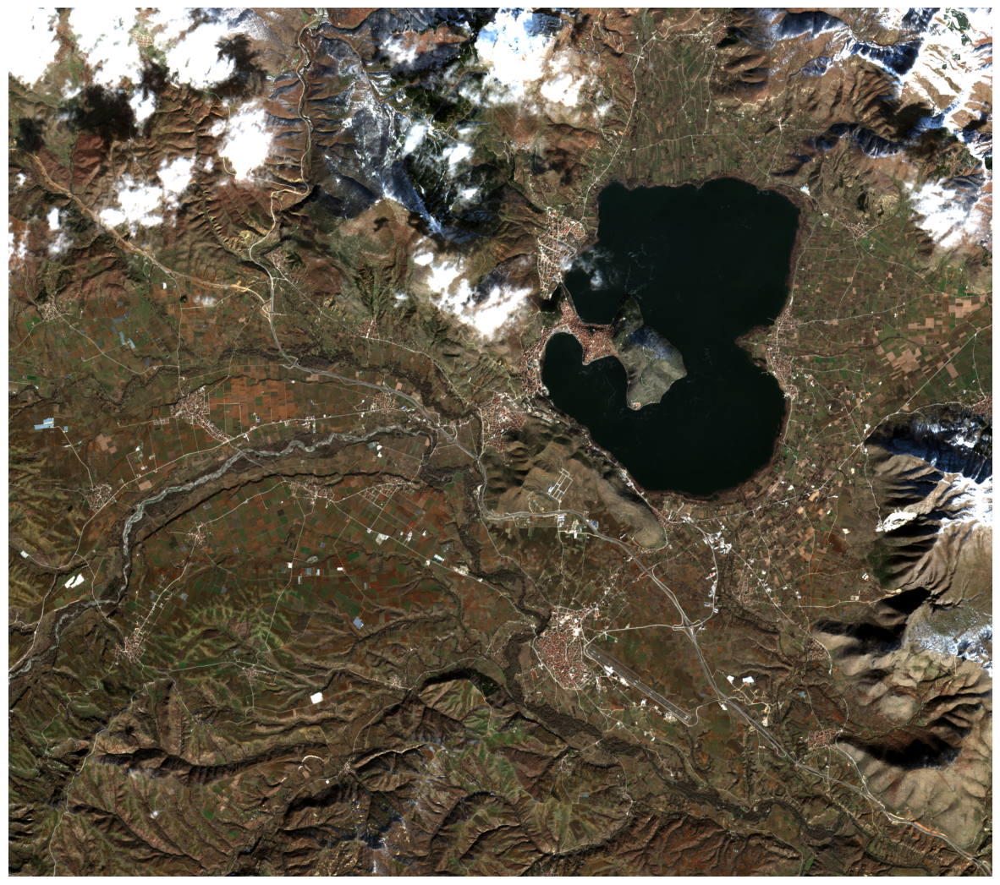

In [7]:
fp = r"Kastoria.tif"

# Open the File
img = rasterio.open (fp)

#print (img.profile)

# Extract Red - Green - Blue of Image (1), Day (25)
b__r, b__g, b__b = img.read (3), img.read (2), img.read (1)

# Normalize the Bands
b__r = normalize (b__r)
b__g = normalize (b__g)
b__b = normalize (b__b)

print (b__r.mean ())

# Create RGB natural color composite
rgb = np.dstack ((b__r, b__g, b__b))

# Display the Image
plt.rcParams [ "figure.figsize" ] = [15, 15]
plt.axis ('off')
plt.imshow (rgb)

#band = img.read (1) ; print (band)
#band = img.read (240) ; print (band)

#print (band[1000:1010, 1000:1010])
#print (band [1000, 1000])

# Show Image
# show (img)

# Channel Interpretation
#print (img.meta)


### 1.β ###

- Εισαγωγή Διανυσματικού Αρχείου GeoJSON με το πολύγωνο του προ-καποδιστριακού Δήμου Μεσοποταμιάς, που απομονώθηκε από το Shapefile των προ-καποδιστριακών ΟΤΑ όπως αυτό μεταφορτώθηκε από τον ιστότοπο geodata.gov.gr.

- Περικοπή της εικόνας στα όρια του Πολυγώνου (Δήμου) και αποθήκευσή του ως νέο αρχείο εκόνας τύπου TFF.

- Άνοιγμα εκ νέου του αρχείου εικόνας, δημιουργία έγχρωμου σύνθετου και εμφάνισή του στην οθόνη.

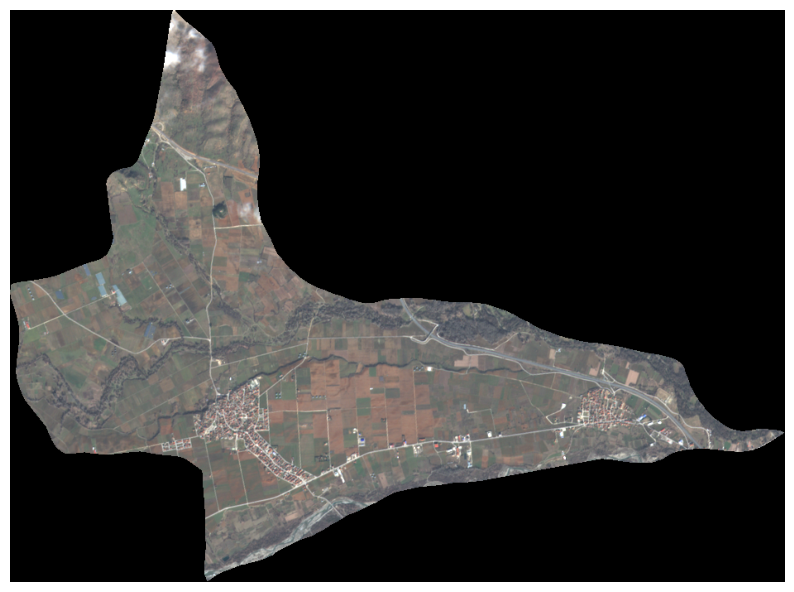

In [8]:
import fiona
import rasterio.mask

# Load Shapefile containing the AOI to be used for clipping the Image 
with fiona.open ("Mesopotamia_final.shp", "r") as Aoi:
    shapes = [feature["geometry"] for feature in Aoi]

# Perform the clipping
out_img, out_transform = rasterio.mask.mask (img, shapes, crop = True, nodata = 0, filled = True)
out_meta = img.meta

# Update the Image Metadata
out_meta.update({
    "driver": "Gtiff",
    "height": out_img.shape[1],
    "width" : out_img.shape[2], 
    "nodata": 0,   
    "transform": out_transform
})

# Save the clipped Image
#with rasterio.open ('Kastor__clip.tif', 'w', **out_meta) as dst:
#     dst.write (out_img)

# Open the clipped Image / Make 3-2-1 RGB composite / Display Image
out_img = rasterio.open ('Kastor__clip.tif')
rgb_img = rgb_composite (out_img , 3, 2, 1 )

# Display the Image
plt.rcParams ["figure.figsize" ] = [10, 10]
plt.axis ('off')
plt.imshow (rgb_img)


### 1.δ Εισαγωγή Corine Land Cover 2018 ###

Χρήση συνάρτησης από το αποθετήριο για εισαγωγή του Corine 2018 για τα όρια της επιλεγμένης γεωμετρίας. Επειδή η διαδικασία με τη χρήση του αρχικού πολυγώνου δεν ήταν επιτυχής, πιθανόν λόγω της πολυπλοκότητας του αρχικού πολυγώνου, χρησιμοποιήθηκε τελικά το περικλείον ορθογώνιο.

In [9]:
import geopandas as gpd

corine ("aoi__kast.shp", True)

corine_shp = gpd.GeoDataFrame.from_file ('corine_2018.shp')
corine_shp = corine_shp.set_crs ('epsg:4326', allow_override = True)
corine_shp.to_file ('corine_2018.shp')


Starting retrieval...
Successfully retrieved data!


## 2. NDVI ##
___


Text(0, 0.5, 'NDBI')

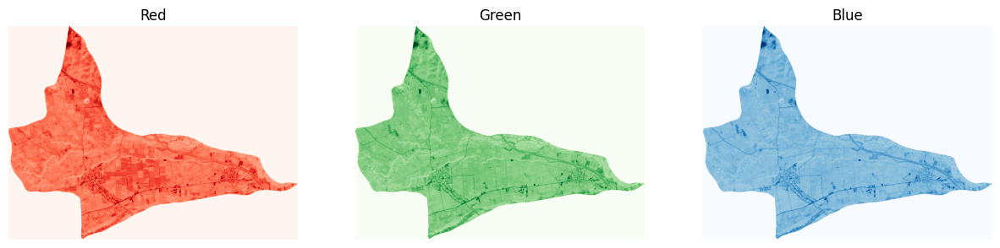

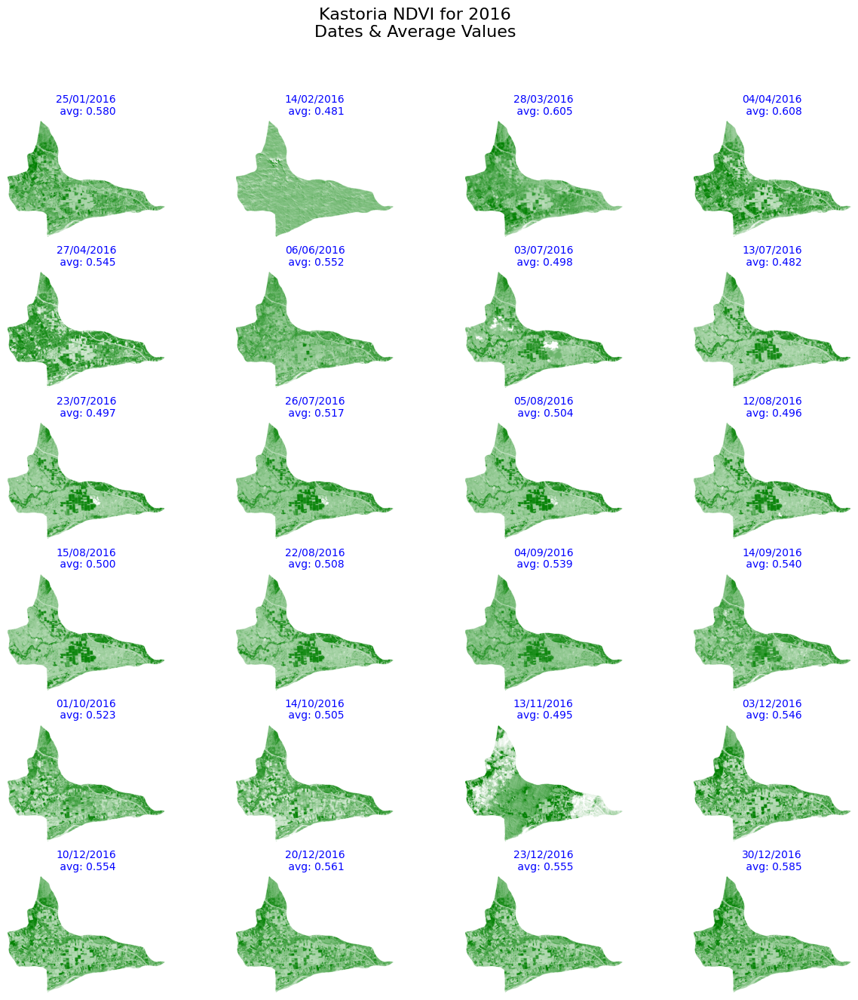

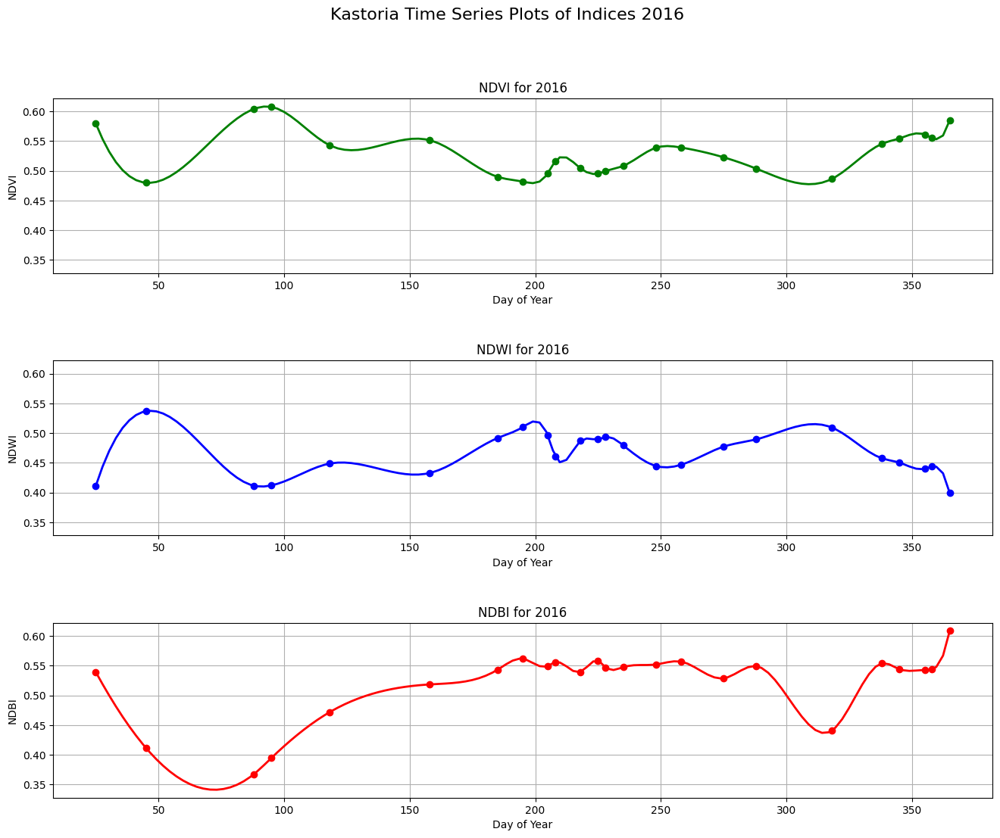

In [10]:
import rasterio
import matplotlib as mpl
import matplotlib.pyplot as plt

from rasterio.plot import show
from scipy.interpolate import make_interp_spline

%matplotlib inline

# Open the clipped Image / Make 3-2-1 RGB composite / Display Image
img_clip = rasterio.open ('Kastor__clip.tif')

# Initialize subplots
fig, (ax1, ax2, ax3) = plt.subplots (ncols = 3 , nrows = 1, figsize = (15, 15), sharey = True)

# Plot Red, Green and Blue (rgb)
show ((img_clip, 3), cmap = 'Reds',   ax = ax1)
show ((img_clip, 2), cmap = 'Greens', ax = ax2)
show ((img_clip, 1), cmap = 'Blues',  ax = ax3)

# Add titles
ax1.set_title ("Red"  ) ; ax1.axis (False)
ax2.set_title ("Green") ; ax2.axis (False)
ax3.set_title ("Blue" ) ; ax3.axis (False)

# =====================================================================================
# For All available Dates, visualize NDVI (Band: 7)
# =====================================================================================
# Initialize subplots
fig, axs = plt.subplots (ncols = 4 , nrows = 6, figsize = (15, 15), sharey = True)

fig.suptitle ('Kastoria NDVI for 2016\nDates & Average Values', fontsize = 16)
fig.subplots_adjust (hspace = 0.3)

row, col = 0, 0

# White to Green Color Palette
cmap = mpl.colors.LinearSegmentedColormap.from_list ('Leon', ['w', 'g'], N = 512)

# Loop over Image Collection and pixck NDVI Channel: 7, 17, 27 ... (10 * i + 7)
# Display NDVI Band and corresponding Date.
for i in range (len (kast_img_dates)):

    idx = 10 * i + 7
    show ((img_clip, idx), cmap = cmap, ax = axs [row, col])

    # Get Average Value for chanel excluding '0'
    band = img_clip.read (idx)
    avg_val = band.mean (where = (band > 0))

    # Title of Image
    axs [row, col].set_title (
        kast_img_dates [i].strftime ('%d/%m/%Y') + 
        '\n avg: ' + f'{avg_val:.3f}'
    )
    
    axs [row, col].title.set_fontsize  (10)
    axs [row, col].title.set_color ('blue')
    axs [row, col].axis (False)
    
    if ((col := col + 1) == 4) : col = 0 ; row += 1
#

# =====================================================================================
# Create and Plot Time Series
# ------------------------------------------------------------------------------------- 
# Calculate Average Value Series for Spectral Indexes: 
#   NDVI: Band  7, 17, 27 ... (10 * i +  7)
#   NDWI: Band  9, 19, 29 ... (10 * i +  9)
#   NDBI: Band 10, 20, 30 ... (10 * (i + 1))
# =====================================================================================
ndvi_series, ndwi_series, ndbi_series = [], [], []

for i in range (len (kast_img_dates)):
    
    # Get Average Value for NDVI chanel excluding '0'
    idx = 10 * i + 7       # Index of NDVI chanel
    ndvi_bnd = img_clip.read (idx)
    ndvi_series.append ( ndvi_bnd.mean (where = (band > 0)) )

    # Get Average Value for NDWI chanel excluding '0'
    idx += 2                # Index of NDWI chanel
    ndwi_bnd = img_clip.read (idx)
    ndwi_series.append ( ndwi_bnd.mean (where = (band > 0)) )

    # Get Average Value for NDBI chanel excluding '0'
    idx += 1                # Index of NDBI chanel
    ndbi_bnd = img_clip.read (idx)
    ndbi_series.append ( ndbi_bnd.mean (where = (band > 0)) )
#

# Plotting Time Series
# ------------------------------------------ 
# Initialize subplots
fig, axs = plt.subplots (ncols = 1 , nrows = 3, figsize = (16, 12), sharey = True)
fig.suptitle ('Kastoria Time Series Plots of Indices 2016', fontsize = 16)
fig.subplots_adjust (hspace = 0.5)

# Plot NDVI Index
plot_series (kast_doy, ndvi_series, axs [0], 'g', 2)
axs [0].set_title  ('NDVI for 2016')
axs [0].set_xlabel ('Day of Year')
axs [0].set_ylabel ('NDVI')

# Plot NDWI Index
plot_series (kast_doy, ndwi_series, axs [1], 'b', 2)
axs [1].set_title  ('NDWI for 2016')
axs [1].set_xlabel ('Day of Year')
axs [1].set_ylabel ('NDWI')

# Plot NDBI Index
plot_series (kast_doy, ndbi_series, axs [2], 'r', 2)
axs [2].set_title  ('NDBI for 2016')
axs [2].set_xlabel ('Day of Year')
axs [2].set_ylabel ('NDBI')


# 3. Χειρισμός Γεω-δεδομένων με χρήση της Βιβλιοθήκης Geopandas #
___


        osm_id  code    fclass                                name   ref   
0     29410865  5113   primary                    Θήβας - Χαλκίδας  ΕΟ44  \
1     26000760  5113   primary                  Λιβαδειάς - Λαμίας   ΕΟ3   
2    193865283  5111  motorway  Αυτοκινητόδρομος Κεντρικής Ελλάδας    Α3   
3     23199941  5113   primary                          Δεληγιώργη   NaN   
4    281000972  5113   primary                  Μεγάλου Αλεξάνδρου  ΕΟ26   
..         ...   ...       ...                                 ...   ...   
815  229521438  5113   primary                  Γρηγορίου Λαμπράκη  ΕΟ39   
816   26813009  5113   primary              Κωνσταντίνου Καραμανλή  ΕΟ90   
817  815443760  5113   primary                   Πατρα - Καλάβρυτα  ΕΟ31   
818  444979657  5113   primary                   Τεσσάρων Μαρτύρων  ΕΟ90   
819  130270967  5113   primary                      28ης Οκτωβρίου   ΕΟ6   

    oneway  maxspeed  layer bridge tunnel   
0        B        50      0      F      F 

(4481312.277638808, 4489228.554235689)

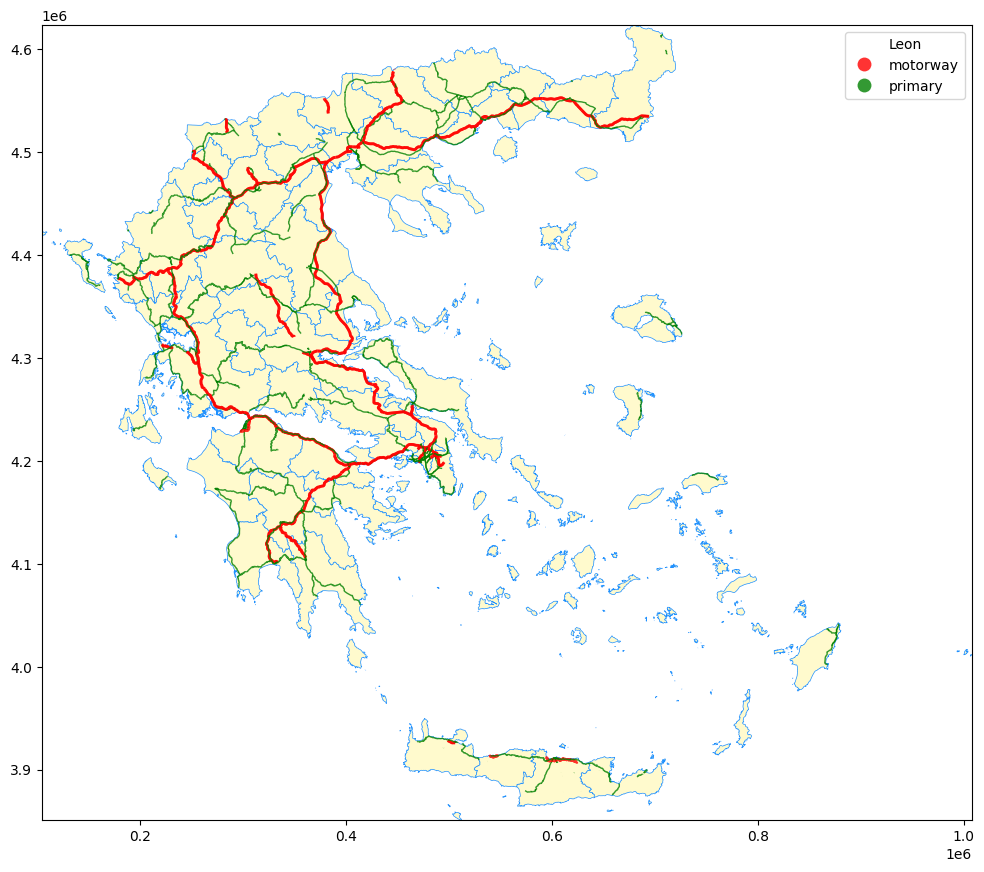

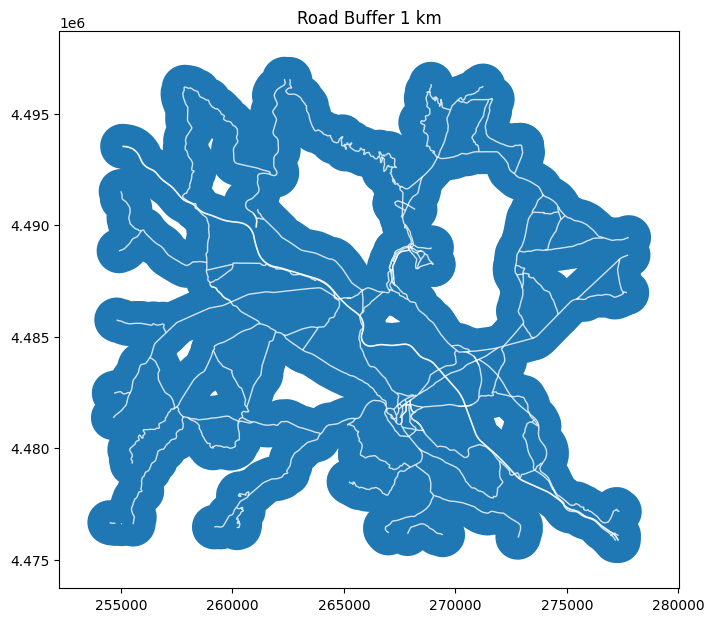

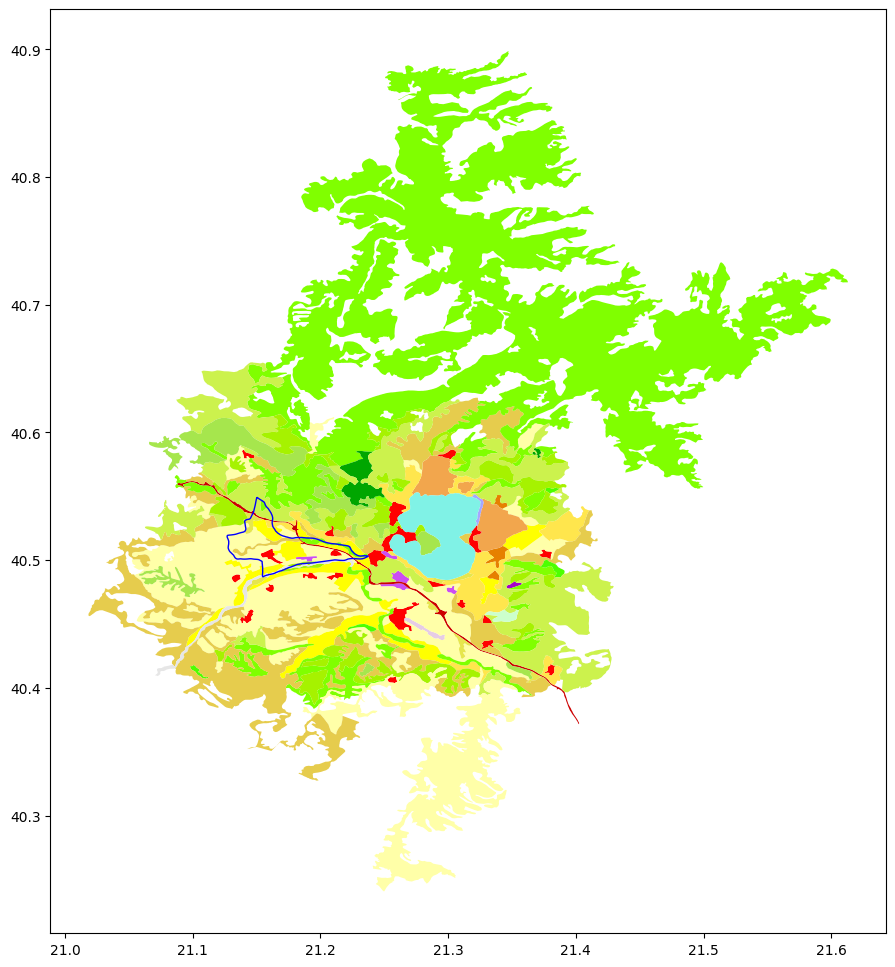

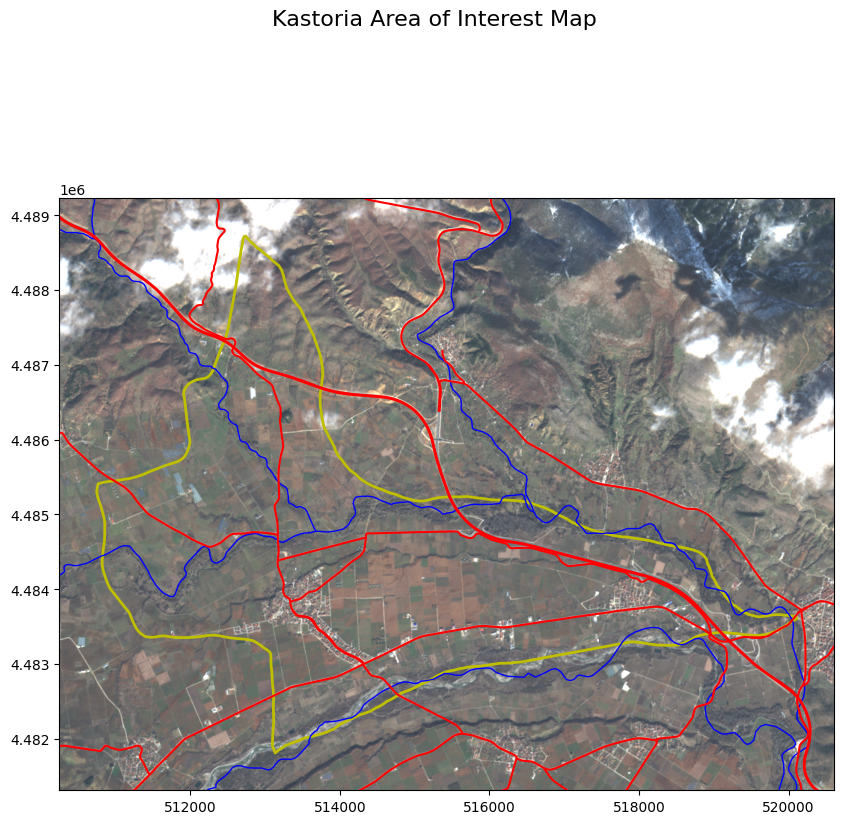

In [11]:
import rasterio
from rasterio.plot import show
import geopandas as gpd
import matplotlib.pyplot as plt
import matplotlib.colors as colors
import mapclassify
import numpy as np

# ===============================================================================
# 3.B   G e o - D a t a   M a n i p u l a t i o n
# ===============================================================================

# Read & display Shapefile Nomoi__gr

nomoi = gpd.read_file ('Nomoi__gr.shp')
#print (nomoi)

ax = nomoi.plot (
    figsize = (12, 12), 
    aspect = 'equal',
    edgecolor = 'DodgerBlue',
    facecolor = 'LemonChiffon',
    linewidth = 0.5
)

# Test: From Nomoi select & plot ARTA
# art = nomoi [nomoi ['NAME_GR'].str.contains ('ΑΡΤ')]   # Οκ
# print (art)
# art.plot ()

# ---------------------------------------------------------------------
#   3.B.0   Test Operation Dissolve on NOMOI dataset
# ---------------------------------------------------------------------

# hellas = nomoi.dissolve ()
# hellas.plot ()
# print (hellas.head())

# ---------------------------------------------------------------------
#   3.B.1   Operation Buffer
#
#           Create a 1 km Buffer Zone around main road features from
#           Shapefile [ gr__roads__main.shp ].
# ---------------------------------------------------------------------

# Open the Roads Shapefile
roads = gpd.read_file ('roads__kast.shp')

# Create empty GeoDataFrame using CRS of [ roads__kast.shp ]
road_buff = gpd.GeoDataFrame (
    columns = ['id', 'geometry'], geometry = 'geometry', crs = 'EPSG:2100'
)

# Create 1 000 m Buffer and display it
road_buff ['geometry'] = roads.to_crs (epsg = 2100).buffer (1000)

ax_buff = road_buff.plot (figsize = (8, 8))
roads.plot (
    ax = ax_buff ,  color = 'w', legend = True,
    linewidth = 1,  alpha = 0.8, legend_kwds = {"title": "Road Buffer 1 km"}
)

ax_buff.set_title ('Road Buffer 1 km')

# ---------------------------------------------------------------------
#   3.B.2   Operation Intersect
#
#           
#           
# ---------------------------------------------------------------------



# ===============================================================================
# T e s t   M a p
# ===============================================================================

# Load Shapefile [gr__roads__main] which contains Motorways, Primary Roads
roads = gpd.read_file ('gr__roads__main.shp')
print (roads)

# Define line width according to Road Category
dict_wdt = { 'motorway' : 2, 'primary' : 1 }
wd_roads = [
    dict_wdt [v] for v in roads ['fclass']
]

# Plot the Dataset
roads.plot (
    ax = ax,
    column  = "fclass",
    categorical = True,
    cmap    = colors.ListedColormap ([ 'red', 'green' ]),
    linewidth = wd_roads,
    alpha  = 0.8,
    legend = True,
    legend_kwds = {"title": "Leon"}
)

minx, miny, maxx, maxy = nomoi.total_bounds
ax.set_xlim (minx, maxx)
ax.set_ylim (miny, maxy)

# ===============================================================================
# 3.D   S t a t i c   M a p s
# ===============================================================================
#       3.D.1   Corine Land Cover Static Map
#
#               Draw Corine Land Cover using the official Color Codes defined
#               in <dict_corine>.
#               Overlay the vector Shapefile [ Mesopotamia_final.shp ] defining AOI
# -------------------------------------------------------------------------------

# Load Corine 2018 Dataset
corine_shp = gpd.GeoDataFrame.from_file ('corine_2018.shp')

# Create a new Color Field from Corine Color Dictionary
corine_shp ['color'] = corine_shp.apply (           # G
    lambda row : dict_corine [int (row [0])], axis = 1
)

color_list = [ dict_corine [int (v)] for v in corine_shp ['Code_18'] ] 

# Create a Listed Colormap to Symbolize the features according to
# their Value
corine_color = colors.ListedColormap (
    corine_shp ['color']      # G
    #color_list
)

# Plot the Dataset
ax_cor = corine_shp.plot (
    figsize   = (12, 12),
    cmap      =  corine_color,
    linewidth = 0
)

# Read Shapefile [ Mesopotamia_final.shp ] defining AOI
aoi = gpd.GeoDataFrame.from_file ('Mesopotamia_final.shp').to_crs (
    corine_shp.crs
)

# Plot AOI on top of Corine Land Cover Layer
aoi.plot (
    ax = ax_cor,
    aspect = 'equal',   edgecolor = 'b',
    facecolor = 'none', linewidth = 1
)

# -------------------------------------------------------------------------------
#       3.D.2   Static Map for Area of Interest
#
#               Draw original Image [ Kastoria.tif ]
#               Overlay vector Shapefile [ Mesopotamia_final.shp ] defining AOI
#               Overlay   "        "     [ hydro__gr.shp ] of streams / rivers
#               Overlay   "        "     [ gr__roads__ok.shp ] of Road Network
# -------------------------------------------------------------------------------

# Initialize subplots
fig, ax_aoi = plt.subplots (figsize = (10, 10))
fig.suptitle ('Kastoria Area of Interest Map', fontsize = 16)

# Read [ Kastoria.tif ] Image
img_kast = rasterio.open ('Kastoria.tif')

# Show [ Kastoria.tif ] as a (3, 2, 1) Color Composite
rasterio.plot.show ((img_kast, [3, 2, 1]), ax = ax_aoi)

# Read Shapefile [ Mesopotamia_final.shp ] defining AOI
aoi = gpd.GeoDataFrame.from_file ('Mesopotamia_final.shp')

# Draw AOI using its initial spatial extents increased by 500 m
aoi.plot (ax = ax_aoi, facecolor='none', edgecolor = 'y', linewidth = 2)

# Open hydrograpfic Network Shapefile & project it to CRS of AOI
hydro = gpd.GeoDataFrame.from_file ('hydro__gr.shp').to_crs (aoi.crs)

hydro.plot (ax = ax_aoi, facecolor='none', edgecolor = 'b', linewidth = 1)

# Open Road Network Shapefile & project it to CRS of AOI
roads2 = gpd.GeoDataFrame.from_file ('gr__roads__ok.shp').to_crs (aoi.crs)

roads2.plot (ax = ax_aoi, facecolor='none', edgecolor = 'r', linewidth = 1.5)


# Limit Map extents to the spatial extents of AOI increased by 500 m
minx, miny, maxx, maxy = aoi.total_bounds

ax_aoi.set_xlim (minx - 500, maxx + 500)
ax_aoi.set_ylim (miny - 500, maxy + 500)

# -------------------------------------------------------------------------------
#       3.D.3   Static Map for Point of Meteo Data
#
# -------------------------------------------------------------------------------



# 4. Διαδραστικοί Χάρτες με χρήση Βιβλιοθηκών: Pandas, Folium, Leafmap #
___

Στην χαρτοσύνθεση χρησιμοποιήθηκαν τα διανυσματικά επίπεδα (Shapefiles):
- Nomoi
- ota__kastor       Οργανισμοί Τοπικής Αυτοδιοίκησης πρό σχεδίου Καποδίστριας, του Νομού ΚΑΣΤΟΡΙΑΣ.
- hydro__kastor     Υδρογραφικό Δίκτυο της ευρύτερης περιοχής
- schools__kastor   Σχολεία της ευρύτερης περιοχής

Τα επίπεδα απεικονίζονται με το δικό του συμβολισμό το καθένα. Επίσης εισάγεται στο χάρτη και ένα στοιχείο ελέγχου (Layer Control Element) το οποίο επιτρέπει στο χρήστη επιλεκτικά να ενεργοποιεί - απενεργοποιεί το κάθε layer.

Για το επίπεδο ΟΤΑ, χρησιμοποιείται highlighting όταν διέρχεται πάνω τους ο δείκτης του ποντικιού και επίσης χρησιμοποιείται αναδυόμενο popup πλαίσιο κειμένου, το οποίο εμφανίζει το ελληνικό όνομα του ΟΤΑ.


In [12]:
import folium
import geopandas as gpd
import numpy as np

# Interactive Map at Kastoria Region
# iMap = folium.Map (location = [40.48, 21.20])
# iMap.save ("index.html")

esri_DeLorme = 'https://server.arcgisonline.com/ArcGIS/rest/services/Specialty/DeLorme_World_Base_Map/MapServer/tile/{z}/{y}/{x}.png'
esri_Topo    = 'https://server.arcgisonline.com/ArcGIS/rest/services/World_Topo_Map/MapServer/tile/{z}/{y}/{x}.png'
esri_sat     = 'https://server.arcgisonline.com/ArcGIS/rest/services/World_Imagery/MapServer/tile/{z}/{y}/{x}'

# Show the Map
# iMap = folium.Map (
#     location = [40.48, 21.20], zoom_start = 11, 
#     tiles = esri_DeLorme,
#     attr = 'Tiles &copy; Esri &mdash; Copyright: &copy;2012 DeLorme'
# ) #

iMap = folium.Map (
    location = [40.48, 21.20], zoom_start = 11, 
    #tiles = esri_Topo,
    #attr = 'Tiles &copy; Esri &mdash' 
) #

iMap.save ("index.html")

# ------------------------------------------------------------------------------
# C o r i n e   2 0 1 8   Layer for AOI
# ------------------------------------------------------------------------------

# Read & display Shapefile corine_2018 using geopanda
corine = gpd.read_file ('corine_2018.shp')
corine.head ()

# Symbology Style Function for Layer OTA
style_corine = lambda x : {
        'color'      : 'DarkKhaki',  'weight'     : 0,
        'fillColor'  : dict_corine [ int (x ['properties']['Code_18']) ],  
        'fillOpacity': 0.5,  
}

# Add Layer OTA to Map. Features will be highlighted while mouse over
# When cklicked, a popup will appeare with its NAME_GREEK property.
folium.GeoJson (
    data = corine, style_function = style_corine,  show = False
).add_to (folium.FeatureGroup (name = 'Corine Land Cover 2018').add_to (iMap))

# ------------------------------------------------------------------------------
# L a y e r   O T A
# ------------------------------------------------------------------------------

# Read & display Shapefile ota__kastor using geopanda
ota = gpd.read_file ('ota__kastor.shp')
ota.head ()

# Symbology Style Function for Layer OTA
style_ota = lambda x : {
        'color'      : 'Orange',  'weight'     : 1,
        'fillColor'  : 'Orange',  'fillOpacity': 0.05,  
}

# Feature Highlight Function for Layer OTA 
hlite_ota = lambda x : {
        'color'      : 'Yellow',  'weight'  : 1,    'opacity' : 1,
        'fillColor'  : 'Yellow',  'fillOpacity': 0.3,  'show_on_map' : True
}

# Add Layer OTA to Map. Features will be highlighted while mouse over
# When cklicked, a popup will appeare with its NAME_GREEK property.
folium.GeoJson ( 
    data = ota,  style_function = style_ota,
    highlight_function = hlite_ota,  
    popup = folium.GeoJsonPopup (fields = ['NAME_GREEK'], labels = False)
    ).add_to (
    folium.FeatureGroup (name = 'OTA').add_to (iMap)
)

# ------------------------------------------------------------------------------
# L a y e r   N o m o i    (Polygon Geometry)
# ------------------------------------------------------------------------------

# Read & display Shapefile Nomoi__gr using geopanda
nomoi = gpd.read_file ('Nomoi__gr.shp')
nomoi.head ()

# Symbology Style Function for Layer Nomoi
style_nomoi = lambda x : {
        'color'     : 'green', 'weight'      : 3, 'opacity' : 0.5,
        'fillColor' : 'green', 'fillOpacity' : 0, 'show_on_map' : False
}

# Add Layer Nomoi to Map
# Use geopandas GeoSeries to draw as a Polylines
folium.GeoJson (
    data = gpd.GeoSeries (nomoi ["geometry"]).boundary, style_function = style_nomoi
).add_to (folium.FeatureGroup (name = 'Nomoi').add_to (iMap))

# ------------------------------------------------------------------------------
# L a y e r   H y d r o   (Line Geometry)
# ------------------------------------------------------------------------------

# Read & display Shapefile hydro__kastor using geopanda
hydro = gpd.read_file ('hydro__kastor.shp')
hydro.head ()

print (hydro.columns)

# Symbology Style Function for Layer Nomoi
style_hydro = lambda x : {
        'color'     : 'DodgerBlue', 
        'weight'    : 0.75 * (6 - x ['properties']['category']),
        'fillColor' : 'RoyalBlue', 'fillOpacity' : 0, 'dashArray' : '6, 3'
}

# Add Layer Nomoi to Map
folium.GeoJson ( data = hydro, style_function = style_hydro ).add_to (
    folium.FeatureGroup (name = 'Hydro').add_to (iMap)
)

# ------------------------------------------------------------------------------
# L a y e r   S c h o o l s   (Point Geometry)
# ------------------------------------------------------------------------------

# Read & display Shapefile hydro__kastor using geopanda
school = gpd.read_file ('schools__kastor.shp')
school.head ()

# Symbology Style Function for Layer Nomoi
style_school = lambda x : {
        'color'     : 'RoyalBlue', 'weight'      : 1,
        'fillColor' : 'RoyalBlue', 'fillOpacity' : 0, 
}

# Add Layer Scools to Map
folium.GeoJson ( 
    data = school, 
    marker = folium.CircleMarker (
        radius = 4, # Radius in metres
        weight = 0, #outline weight
        fill_color = 'MediumOrchid', 
        fill_opacity = 1
    ), 
    popup = folium.GeoJsonPopup (fields = ['onoma'], labels = True)
    #style_function = style_school
).add_to (
    folium.FeatureGroup (name = 'Schools - Click to show Info').add_to (iMap)
)

# ------------------------------------------------------------------------------
# Add   W M S  (Web Map Services)  Layers
# ------------------------------------------------------------------------------

folium.raster_layers.WmsTileLayer (
    url = 'https://maps.heigit.org/osm-wms/service?',
    layers = 'europe_wms:hs_srtm_europa',
    transparent = True, 
    control = True, 
    name = 'geocradle_dem',
    overlay = False,
    show = False,   
).add_to (iMap)

folium.raster_layers.WmsTileLayer (
    url = 'https://gisco-services.ec.europa.eu/maps/service?',
    layers = 'Copernicus',
    transparent = True, 
    control = True, 
    name = 'Copernicus Europe satellite Core003',
    overlay = False,
    show = False,
).add_to (iMap)

# Hellas Hydrographic Network retrieved from [geodata.gov.gr]
folium.raster_layers.WmsTileLayer (
    url = 'http://www.rae.gr/geoserver/ows?amp;request=GetCapabilities',
    layers = 'urn:uuid:1f4bfcfb-532c-42d0-a9d1-326068ba8a11',
    transparent = True, 
    control = True, 
    name = 'Hellas Hydro Network',
    overlay = False,
    show = False,
).add_to (iMap)

folium.raster_layers.TileLayer(
    tiles='OpenStreetMap', name='Open Street Map'
).add_to(iMap)

folium.raster_layers.TileLayer(
    tiles = esri_sat, attr = 'Esri', name = 'Esri Satellite'
).add_to(iMap)

folium.raster_layers.TileLayer(
    tiles = "https://services.arcgisonline.com/arcgis/rest/services/World_Shaded_Relief/MapServer/tile/{z}/{y}/{x}",
    attr = 'Esri', 
    name = 'Esri Shaded Relief'
).add_to(iMap)


# Add Layer Control Element to Map
folium.LayerControl().add_to(iMap)
iMap


Index(['GREEK_NAME', 'LATIN_NAME', 'category', 'shape_leng', 'geometry'], dtype='object')
